In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
#pip install pandas_ta

In [3]:
import pandas_ta as ta

In [4]:
import random
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [5]:
# Everything concerning USDTRY pair is done here, after testing the models CHECK THIS PART!
bist_daily = pd.read_csv("datasets/bist_100_daily.csv")
usdtry_daily = pd.read_csv('datasets/USDTRY_daily.csv')
usdtry_daily = usdtry_daily[["Date","USDTRY_Close"]]
usdtry_daily["Date"]=pd.to_datetime(usdtry_daily["Date"])
bist_daily["Date"] = pd.to_datetime(bist_daily["Date"])
bist_daily = bist_daily.merge(usdtry_daily, how='inner',on="Date")


# Extract the number of rows and columns by using the shape of the data.
numRows,numColumns = bist_daily.shape
# Extract the time interval.
last_date, first_date = bist_daily.iloc[0].Date, bist_daily.iloc[-1].Date
# Check the availability of the data.
na_cols = bist_daily.columns[bist_daily.isna().any()].tolist()

# Print the information.
print(f"There are {numRows} rows and {numColumns} columns in the initial dataset.")
print(f"The data represents the time frame between the dates '{last_date}' and '{first_date}'.")
if not na_cols:
    print("There are no NA rows.")
else:
    print(f"Columns in the dataset which include NA rows: {na_cols}.")
# Convert columns to numeric values
column_names = ["Price", "Open", "High", "Low"]
for column in column_names:
    bist_daily[column] = bist_daily[column].str.replace(',', '')
    bist_daily[column] = pd.to_numeric(bist_daily[column])
# CONVERT TO DATETIME FORMAT AND SORT DATA BY DATE
bist_daily.Date = pd.to_datetime(bist_daily.Date)
bist_daily.sort_values(by="Date", ignore_index=True,inplace=True)
bist_daily.set_index(pd.DatetimeIndex(bist_daily["Date"]), inplace=True)
bist_daily.rename(columns={"Price": "close"},inplace=True)
# Calculate Returns and append to the df DataFrame
# CUMLOGRET_1 and CUMPCTRET_1 are added (NaN values exists)
bist_daily.ta.log_return(cumulative=True, append=True)
bist_daily.ta.percent_return(cumulative=True, append=True)
# Returns a list of indicators and utility functions (to check in future)
ind_list = bist_daily.ta.indicators(as_list=True)
# RSI_14, MACD_12_26_9, MACDh_12_26_9 and MACDs_12_26_9 are added (NaN values exists)
bist_daily.ta.rsi(append=True)
bist_daily.ta.macd(append=True)
# SMA values are added (use ta in the future)
sma_values = [5, 10, 15] 
for i in sma_values:
    bist_daily['SMA'+str(i)] = bist_daily['close'].rolling(window=i).mean()
# Remove all NaN value rows
bist_daily.dropna(inplace=True)
bist_daily

There are 4285 rows and 8 columns in the initial dataset.
The data represents the time frame between the dates '2019-12-02 00:00:00' and '2000-01-05 00:00:00'.
There are no NA rows.


,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38.20M,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60.08M,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53.29M,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33.31M,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44.39M,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1.04B,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970.54M,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1.81B,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


{1: 2938, 2: 308, 3: 775, 4: 125, 5: 64, 6: 15, 7: 10, 10: 3, 11: 3, 12: 2, 28: 1, 29: 2, 31: 4, 60: 1}


<BarContainer object of 14 artists>

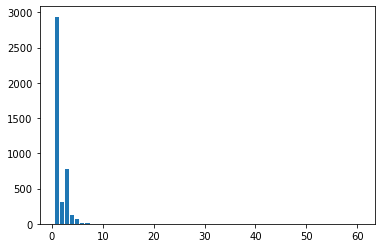

In [6]:
diff = [] 
for date1, date2 in zip(bist_daily["date"][:-1], bist_daily["date"][1:]): 
    diff.append((date2-date1).days) 
unique, counts = np.unique(np.asarray(diff), return_counts=True) 
count_dict = dict(zip(unique, counts)) 
print(count_dict) 
plt.bar(unique,counts)

In [7]:
# edit Vol. column

from operator import itemgetter

vols = bist_daily['Vol.'].to_list()
#[vol[-1] for vol in vols]
#list(filter(lambda vol: "-" in vol,enumerate(vols)))

indexToRemove = bist_daily.iloc[list(map(itemgetter(0),filter(lambda vol: "-" in vol,enumerate(vols))))].index
bist_daily.drop(indexToRemove,inplace=True)
bist_daily['Vol.'] = bist_daily['Vol.'].apply(
    lambda x: float(x[:-1])*(10**6) if x[-1]=="M" else (float(x[:-1])*(10**9) if x[-1]=="B" else "ERROR")).astype("int")
bist_daily

,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38200000,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60080000,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53290000,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33310000,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44390000,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1040000000,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970540000,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1810000000,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


In [8]:
# seeding an arbitrary number to get same results in multiple runs
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Seed:", manualSeed)

Seed: 999


In [9]:
# getting number of GPUs from cuda
ngpu = torch.cuda.device_count()
print("Count of available GPUs:", ngpu)

Count of available GPUs: 1


In [10]:
# printing the name of available GPUs
for i in range(ngpu):
    print("GPU {}: {}".format(i+1, torch.cuda.get_device_name(i)))

GPU 1: GeForce RTX 2060


In [11]:
# batch size for the training
batch_size = 64

# optimizer rates
optimizer_betas = (0.9, 0.999)
learning_rate = 5e-4

# number of epochs
num_epochs = 3000

# evaluate after evaluation_epoch_num epochs
evaluation_epoch_num = 5

# decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [12]:
class TimeseriesDataset(Dataset):
    def __init__(self, data_frame, sequence_length=2):
        self.data = torch.tensor(data_frame.values)
        self.sequence_length = sequence_length

    def __len__(self):
        return self.data.shape[0] - self.sequence_length + 1

    def __getitem__(self, index):
        return self.data[index: index + self.sequence_length].float()
    
    # Non-overlapping series
    # def __getitem__(self, index):
    #     return self.data[index * self.sequence_length: (index+1) * self.sequence_length]

In [13]:
# create pytorch dataset from the pandas DataFrame

# TODO: Convert change(%) and Volume columns to numeric values
columns_used_in_training = ["close", "open", "high", "low", "CUMLOGRET_1", "RSI_14", "MACD_12_26_9", "SMA5"]
# input dimension of the generator
data_dimension = len(columns_used_in_training)
# sequence length of input data
sequence_length = 7

train_data, rest_data = train_test_split(bist_daily[columns_used_in_training], test_size=0.2, shuffle=False)

scaler = MinMaxScaler()
scaler.fit(train_data)
train_data[train_data.columns] = scaler.transform(train_data)
rest_data[rest_data.columns] = scaler.transform(rest_data)

validation_data, test_data = train_test_split(rest_data, test_size=0.5, shuffle=False)

train_dataset = TimeseriesDataset(train_data, sequence_length)
test_dataset = TimeseriesDataset(test_data, sequence_length)
validation_dataset = TimeseriesDataset(validation_data, sequence_length)

# create the dataloader
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
real_data_sample = next(iter(train_dataloader))
print("Real data sample shape:", real_data_sample.shape)

Real data sample shape: torch.Size([64, 7, 8])


In [14]:
class Generator(nn.Module):
    def __init__(self, hidden_size):
        super(Generator, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Linear(hidden_size, data_dimension)
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        res = res.view(res.shape[0], 1, -1)
        return res

In [15]:
class Discriminator(nn.Module):
    def __init__(self, hidden_size):
        super(Discriminator, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Sequential(
            nn.Linear(hidden_size, 1),
            nn.Sigmoid() 
        )
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        res = res.view(res.shape[0], 1, -1)
        return res

In [16]:
def model_rmse(model, dataloader, epoch, plot_graph=False, plot_title="Validation Predictions"):
    rmse = 0
    squared_error_list = []
    real_data_list = []
    predicted_data_list = []
    for i, sequence_batch in enumerate(dataloader):
        with torch.no_grad():
            real_sequence = sequence_batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            real_values = sequence_batch[:,-1:]
            #  Generate (t+1)th value from first t values
            predicted_values = generator(generator_input_sequence).cpu()
            real_data_list.append(real_values)
            predicted_data_list.append(predicted_values)
    
    real_data = torch.cat(real_data_list, 0)
    predicted_data = torch.cat(predicted_data_list, 0)
    
    # Unscale data
    df_pred = pd.DataFrame(predicted_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_pred_unscaled = pd.DataFrame(scaler.inverse_transform(df_pred),columns=columns_used_in_training)
    df_real = pd.DataFrame(real_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_real_unscaled = pd.DataFrame(scaler.inverse_transform(df_real),columns=columns_used_in_training)
    
    if plot_graph:
        if not os.path.exists('./plots/'):
            os.makedirs('./plots/')
        
        # TODO: get x values and plot prediction of multiple columns
        fig = plt.figure(figsize=(16,8))
        plt.xlabel("Date")
        plt.ylabel("Close Price")
        plt.title(plot_title)
        plt.plot(df_real_unscaled['close'],label="Real")
        plt.plot(df_pred_unscaled['close'],label="Predicted")
        # plt.ylim(bottom=0)
        plt.legend()
        fig.savefig('./plots/plt_epoch_{}.png'.format(epoch))
        plt.close(fig)
        
    squared_errors = (df_real_unscaled['close'] - df_pred_unscaled['close'])**2
    rmse = np.sqrt(squared_errors.mean())
    return rmse

In [17]:
# TODO: weight initialization of models

In [18]:
generator = Generator(hidden_size=data_dimension*2).to(device)
discriminator = Discriminator(hidden_size=data_dimension*2).to(device)
print("Generator and discriminator are initialized")

C:\Users\yildi\anaconda3\lib\site-packages\torch\nn\modules\rnn.py:58: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


Generator and discriminator are initialized


In [19]:
criterion = nn.BCELoss()
optimizer_generator = optim.Adam(generator.parameters(), lr=learning_rate, betas=optimizer_betas)
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=optimizer_betas)

real_label = 1.
fake_label = 0.

In [20]:
if not os.path.exists('./models/'):
    os.makedirs('./models/')

In [21]:
evaluation_metrics = {"gen_loss":[], "disc_loss":[], "rmse":[]}
                      
print("Training is started")
for epoch in range(num_epochs):
    for i, sequence_batch in enumerate(train_dataloader):
            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Training with real batch
            discriminator.zero_grad()
            # Format batch
            real_sequence = sequence_batch.to(device)
            batch_size = real_sequence.size(0)
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            discriminator_output_real = discriminator(real_sequence).view(-1)
            # Calculate loss on all-real batch
            discriminator_error_real = criterion(discriminator_output_real, real_labels)
            # Calculate gradients for D in backward pass
            discriminator_error_real.backward()

            ## Training with fake batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            #  Generate (t+1)th value from first t values
            generated_values = generator(generator_input_sequence)
            fake_labels = torch.full((batch_size,), fake_label, dtype=torch.float, device=device)
            # Concat first t real values and generated (t+1)th values
            generator_result_concat = torch.cat((generator_input_sequence, generated_values.detach()), 1)
            # Classify all fake batch with D
            discriminator_output_fake = discriminator(generator_result_concat).view(-1)
            # Calculate D's loss on the all-fake batch
            discriminator_error_fake = criterion(discriminator_output_fake, fake_labels)
            # Calculate the gradients for this batch
            discriminator_error_fake.backward()
            # Add the gradients from the all-real and all-fake batches
            discriminator_error = discriminator_error_real + discriminator_error_fake
            # Update D
            optimizer_discriminator.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            generator.zero_grad()
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Since we just updated D, perform another forward pass of all-fake batch through D
            generator_result_concat_grad = torch.cat((generator_input_sequence, generated_values), 1)
            discriminator_output_fake = discriminator(generator_result_concat_grad).view(-1)
            # Calculate G's loss based on this output
            generator_error = criterion(discriminator_output_fake, real_labels)
            # Calculate gradients for G
            generator_error.backward()
            # Update G
            optimizer_generator.step()
    if (epoch+1) % 5 == 0 or epoch+1 == 1:
        rmse = model_rmse(generator, validation_dataloader, epoch=(epoch+1), plot_graph=True)
        evaluation_metrics["rmse"].append(rmse)
        evaluation_metrics["gen_loss"].append(generator_error.item())
        evaluation_metrics["disc_loss"].append(discriminator_error.item())
        print('\n[{}/{}]\tDiscriminator Loss: {:.4f}\tGenerator Loss: {:.4f}   \tRMSE:{:.4f}'
                  .format(epoch+1, num_epochs, discriminator_error.item(), generator_error.item(), rmse))
        for col_name, real, generated in zip(columns_used_in_training, sequence_batch[0][-1], generated_values[0][0]):
            print(f"{col_name} | Real:{real:.4f} / Generated:{generated:.4f}")
        save_path = os.path.join("./models/","model_epoch_{}.pt".format(epoch+1))
        torch.save({
            'epoch': epoch+1,
            'generator_model_state_dict': generator.state_dict(),
            'discriminator_model_state_dict': discriminator.state_dict(),
            'optimizer_generator_state_dict': optimizer_generator.state_dict(),
            'optimizer_discriminator_state_dict': optimizer_discriminator.state_dict(),
            'discriminator_loss': discriminator_error,
            'generator_loss': generator_error,
            }, save_path)

Training is started

[1/3000]	Discriminator Loss: 1.3688	Generator Loss: 0.6719   	RMSE:589.0893
close | Real:0.2023 / Generated:0.0721
open | Real:0.2009 / Generated:0.2373
high | Real:0.1991 / Generated:-0.1071
low | Real:0.2055 / Generated:0.0098
CUMLOGRET_1 | Real:0.4804 / Generated:0.1807
RSI_14 | Real:0.5618 / Generated:0.2097
MACD_12_26_9 | Real:0.6826 / Generated:0.1870
SMA5 | Real:0.2081 / Generated:0.1336

[5/3000]	Discriminator Loss: 1.3934	Generator Loss: 0.6928   	RMSE:956.0609
close | Real:0.8539 / Generated:-0.2867
open | Real:0.8460 / Generated:0.1319
high | Real:0.8530 / Generated:0.3584
low | Real:0.8603 / Generated:1.1081
CUMLOGRET_1 | Real:0.9435 / Generated:0.1297
RSI_14 | Real:0.5612 / Generated:0.1154
MACD_12_26_9 | Real:0.5527 / Generated:0.6536
SMA5 | Real:0.8506 / Generated:-0.2255

[10/3000]	Discriminator Loss: 1.3911	Generator Loss: 0.7032   	RMSE:276.9062
close | Real:0.6292 / Generated:0.5032
open | Real:0.6261 / Generated:0.4969
high | Real:0.6277 / Gener


[105/3000]	Discriminator Loss: 1.4230	Generator Loss: 0.6830   	RMSE:256.9449
close | Real:0.3813 / Generated:0.2552
open | Real:0.3906 / Generated:0.3279
high | Real:0.3878 / Generated:0.1574
low | Real:0.3881 / Generated:0.5679
CUMLOGRET_1 | Real:0.6701 / Generated:0.7131
RSI_14 | Real:0.2427 / Generated:0.6671
MACD_12_26_9 | Real:0.5386 / Generated:0.9896
SMA5 | Real:0.3994 / Generated:0.5864

[110/3000]	Discriminator Loss: 1.3725	Generator Loss: 0.6806   	RMSE:360.4259
close | Real:0.5853 / Generated:1.1043
open | Real:0.5944 / Generated:-0.0498
high | Real:0.5912 / Generated:0.5966
low | Real:0.5974 / Generated:0.2363
CUMLOGRET_1 | Real:0.8119 / Generated:0.5804
RSI_14 | Real:0.5147 / Generated:0.5493
MACD_12_26_9 | Real:0.5084 / Generated:0.1649
SMA5 | Real:0.5846 / Generated:0.1644

[115/3000]	Discriminator Loss: 1.3757	Generator Loss: 0.7588   	RMSE:300.2113
close | Real:0.7860 / Generated:0.5094
open | Real:0.7977 / Generated:0.9196
high | Real:0.7960 / Generated:1.1394
low |


[210/3000]	Discriminator Loss: 1.4248	Generator Loss: 0.6998   	RMSE:124.4014
close | Real:0.2342 / Generated:0.1055
open | Real:0.2315 / Generated:0.3281
high | Real:0.2349 / Generated:0.3184
low | Real:0.2387 / Generated:0.2442
CUMLOGRET_1 | Real:0.5216 / Generated:0.4417
RSI_14 | Real:0.7545 / Generated:0.7013
MACD_12_26_9 | Real:0.7325 / Generated:0.8779
SMA5 | Real:0.2310 / Generated:0.0388

[215/3000]	Discriminator Loss: 1.3720	Generator Loss: 0.6977   	RMSE:134.7665
close | Real:0.1139 / Generated:0.1227
open | Real:0.1093 / Generated:0.0062
high | Real:0.1118 / Generated:0.0225
low | Real:0.1149 / Generated:0.0338
CUMLOGRET_1 | Real:0.3360 / Generated:0.2248
RSI_14 | Real:0.6208 / Generated:0.5236
MACD_12_26_9 | Real:0.6739 / Generated:0.5845
SMA5 | Real:0.1103 / Generated:0.1626

[220/3000]	Discriminator Loss: 1.3894	Generator Loss: 0.7308   	RMSE:88.3681
close | Real:0.0260 / Generated:0.0023
open | Real:0.0272 / Generated:-0.0570
high | Real:0.0235 / Generated:-0.0953
low |


[315/3000]	Discriminator Loss: 1.3834	Generator Loss: 0.6964   	RMSE:130.3995
close | Real:0.0413 / Generated:-0.0133
open | Real:0.0405 / Generated:-0.0862
high | Real:0.0383 / Generated:0.0141
low | Real:0.0451 / Generated:0.0548
CUMLOGRET_1 | Real:0.1570 / Generated:0.0849
RSI_14 | Real:0.4176 / Generated:0.4350
MACD_12_26_9 | Real:0.6117 / Generated:0.6185
SMA5 | Real:0.0400 / Generated:-0.0437

[320/3000]	Discriminator Loss: 1.3893	Generator Loss: 0.6901   	RMSE:114.3888
close | Real:0.2079 / Generated:0.2271
open | Real:0.2133 / Generated:0.3804
high | Real:0.2158 / Generated:0.2732
low | Real:0.2037 / Generated:0.2192
CUMLOGRET_1 | Real:0.4879 / Generated:0.4610
RSI_14 | Real:0.1563 / Generated:0.2207
MACD_12_26_9 | Real:0.1356 / Generated:0.2126
SMA5 | Real:0.2201 / Generated:0.3913

[325/3000]	Discriminator Loss: 1.3964	Generator Loss: 0.7005   	RMSE:80.5330
close | Real:0.1101 / Generated:0.1541
open | Real:0.1068 / Generated:0.1119
high | Real:0.1067 / Generated:0.0917
low 


[420/3000]	Discriminator Loss: 1.3747	Generator Loss: 0.6939   	RMSE:66.9631
close | Real:0.4196 / Generated:0.5289
open | Real:0.4118 / Generated:0.3662
high | Real:0.4191 / Generated:0.4269
low | Real:0.4212 / Generated:0.5122
CUMLOGRET_1 | Real:0.7009 / Generated:0.6687
RSI_14 | Real:0.6693 / Generated:0.3824
MACD_12_26_9 | Real:0.7403 / Generated:0.8439
SMA5 | Real:0.4154 / Generated:0.5150

[425/3000]	Discriminator Loss: 1.3891	Generator Loss: 0.6930   	RMSE:54.5347
close | Real:0.3613 / Generated:0.4121
open | Real:0.3540 / Generated:0.3426
high | Real:0.3580 / Generated:0.3683
low | Real:0.3623 / Generated:0.3902
CUMLOGRET_1 | Real:0.6529 / Generated:0.6465
RSI_14 | Real:0.4125 / Generated:0.5540
MACD_12_26_9 | Real:0.5743 / Generated:0.4947
SMA5 | Real:0.3628 / Generated:0.3801

[430/3000]	Discriminator Loss: 1.3815	Generator Loss: 0.6831   	RMSE:80.9806
close | Real:0.5715 / Generated:0.5221
open | Real:0.5926 / Generated:0.6438
high | Real:0.5897 / Generated:0.6441
low | Rea


[525/3000]	Discriminator Loss: 1.3895	Generator Loss: 0.6905   	RMSE:62.9346
close | Real:0.2470 / Generated:0.2835
open | Real:0.2475 / Generated:0.1340
high | Real:0.2462 / Generated:0.3361
low | Real:0.2526 / Generated:0.2327
CUMLOGRET_1 | Real:0.5370 / Generated:0.5039
RSI_14 | Real:0.7746 / Generated:0.5107
MACD_12_26_9 | Real:0.7045 / Generated:0.8833
SMA5 | Real:0.2463 / Generated:0.2565

[530/3000]	Discriminator Loss: 1.3877	Generator Loss: 0.6874   	RMSE:60.9978
close | Real:0.7492 / Generated:0.8938
open | Real:0.7594 / Generated:0.6857
high | Real:0.7603 / Generated:0.8657
low | Real:0.7634 / Generated:0.8693
CUMLOGRET_1 | Real:0.8974 / Generated:0.8911
RSI_14 | Real:0.6439 / Generated:0.7631
MACD_12_26_9 | Real:0.7986 / Generated:0.7034
SMA5 | Real:0.7698 / Generated:0.8436

[535/3000]	Discriminator Loss: 1.3893	Generator Loss: 0.6922   	RMSE:107.8312
close | Real:0.5144 / Generated:0.4023
open | Real:0.5074 / Generated:0.5427
high | Real:0.5126 / Generated:0.5416
low | Re


[630/3000]	Discriminator Loss: 1.3815	Generator Loss: 0.6915   	RMSE:45.9472
close | Real:0.0487 / Generated:0.0789
open | Real:0.0514 / Generated:0.0641
high | Real:0.0484 / Generated:0.0755
low | Real:0.0521 / Generated:0.1578
CUMLOGRET_1 | Real:0.1794 / Generated:0.1183
RSI_14 | Real:0.5746 / Generated:0.6765
MACD_12_26_9 | Real:0.6243 / Generated:0.6390
SMA5 | Real:0.0470 / Generated:0.0124

[635/3000]	Discriminator Loss: 1.3855	Generator Loss: 0.7030   	RMSE:42.1224
close | Real:0.5552 / Generated:0.6060
open | Real:0.5572 / Generated:0.5755
high | Real:0.5580 / Generated:0.6804
low | Real:0.5649 / Generated:0.6235
CUMLOGRET_1 | Real:0.7940 / Generated:0.8107
RSI_14 | Real:0.6091 / Generated:0.5453
MACD_12_26_9 | Real:0.6921 / Generated:0.8049
SMA5 | Real:0.5630 / Generated:0.5764

[640/3000]	Discriminator Loss: 1.3962	Generator Loss: 0.6926   	RMSE:57.9177
close | Real:0.0702 / Generated:0.0122
open | Real:0.0675 / Generated:0.1027
high | Real:0.0669 / Generated:0.0048
low | Rea


[735/3000]	Discriminator Loss: 1.3914	Generator Loss: 0.6914   	RMSE:57.2991
close | Real:0.0171 / Generated:-0.0030
open | Real:0.0198 / Generated:0.0428
high | Real:0.0177 / Generated:-0.0135
low | Real:0.0210 / Generated:0.0380
CUMLOGRET_1 | Real:0.0727 / Generated:0.2009
RSI_14 | Real:0.4094 / Generated:0.4003
MACD_12_26_9 | Real:0.5474 / Generated:0.5851
SMA5 | Real:0.0141 / Generated:0.0518

[740/3000]	Discriminator Loss: 1.3829	Generator Loss: 0.6994   	RMSE:43.2355
close | Real:0.8736 / Generated:0.9271
open | Real:0.8806 / Generated:0.7799
high | Real:0.8799 / Generated:1.0175
low | Real:0.8879 / Generated:0.9518
CUMLOGRET_1 | Real:0.9516 / Generated:1.0117
RSI_14 | Real:0.4621 / Generated:0.4338
MACD_12_26_9 | Real:0.5818 / Generated:0.8635
SMA5 | Real:0.8870 / Generated:0.8232

[745/3000]	Discriminator Loss: 1.3937	Generator Loss: 0.6903   	RMSE:37.6082
close | Real:0.1382 / Generated:0.1986
open | Real:0.1427 / Generated:0.1076
high | Real:0.1393 / Generated:0.1906
low | R


[840/3000]	Discriminator Loss: 1.3901	Generator Loss: 0.6888   	RMSE:33.2269
close | Real:0.2299 / Generated:0.2532
open | Real:0.2375 / Generated:0.2156
high | Real:0.2339 / Generated:0.2598
low | Real:0.2358 / Generated:0.2311
CUMLOGRET_1 | Real:0.5164 / Generated:0.6513
RSI_14 | Real:0.4305 / Generated:0.5847
MACD_12_26_9 | Real:0.6340 / Generated:0.6544
SMA5 | Real:0.2373 / Generated:0.2722

[845/3000]	Discriminator Loss: 1.3851	Generator Loss: 0.6910   	RMSE:60.1447
close | Real:0.0265 / Generated:0.0304
open | Real:0.0249 / Generated:0.1065
high | Real:0.0238 / Generated:0.0356
low | Real:0.0284 / Generated:0.0225
CUMLOGRET_1 | Real:0.1076 / Generated:0.1182
RSI_14 | Real:0.3819 / Generated:0.4743
MACD_12_26_9 | Real:0.4937 / Generated:0.4717
SMA5 | Real:0.0213 / Generated:-0.0551

[850/3000]	Discriminator Loss: 1.3823	Generator Loss: 0.6930   	RMSE:29.8098
close | Real:0.6798 / Generated:0.7131
open | Real:0.6982 / Generated:0.6614
high | Real:0.6952 / Generated:0.7630
low | Re


[945/3000]	Discriminator Loss: 1.3872	Generator Loss: 0.6885   	RMSE:72.4069
close | Real:0.3239 / Generated:0.3836
open | Real:0.3221 / Generated:0.2644
high | Real:0.3230 / Generated:0.2891
low | Real:0.3288 / Generated:0.2724
CUMLOGRET_1 | Real:0.6186 / Generated:0.5003
RSI_14 | Real:0.7431 / Generated:0.7734
MACD_12_26_9 | Real:0.8830 / Generated:0.8305
SMA5 | Real:0.3280 / Generated:0.3086

[950/3000]	Discriminator Loss: 1.3892	Generator Loss: 0.6968   	RMSE:27.0242
close | Real:0.2333 / Generated:0.2206
open | Real:0.2398 / Generated:0.3166
high | Real:0.2385 / Generated:0.1925
low | Real:0.2400 / Generated:0.2085
CUMLOGRET_1 | Real:0.5205 / Generated:0.5022
RSI_14 | Real:0.4834 / Generated:0.5569
MACD_12_26_9 | Real:0.6574 / Generated:0.7086
SMA5 | Real:0.2409 / Generated:0.2850

[955/3000]	Discriminator Loss: 1.3813	Generator Loss: 0.6913   	RMSE:59.2473
close | Real:0.9876 / Generated:0.8980
open | Real:0.9820 / Generated:0.8357
high | Real:0.9867 / Generated:0.9067
low | Rea


[1050/3000]	Discriminator Loss: 1.3863	Generator Loss: 0.6896   	RMSE:28.8254
close | Real:0.3284 / Generated:0.3129
open | Real:0.3333 / Generated:0.3325
high | Real:0.3323 / Generated:0.2528
low | Real:0.3355 / Generated:0.3714
CUMLOGRET_1 | Real:0.6229 / Generated:0.6225
RSI_14 | Real:0.6082 / Generated:0.7056
MACD_12_26_9 | Real:0.7295 / Generated:0.7120
SMA5 | Real:0.3295 / Generated:0.3701

[1055/3000]	Discriminator Loss: 1.3852	Generator Loss: 0.6918   	RMSE:25.4822
close | Real:0.0560 / Generated:0.0383
open | Real:0.0557 / Generated:0.0298
high | Real:0.0555 / Generated:0.1901
low | Real:0.0592 / Generated:0.0003
CUMLOGRET_1 | Real:0.2004 / Generated:0.2355
RSI_14 | Real:0.8535 / Generated:0.7710
MACD_12_26_9 | Real:0.6661 / Generated:0.6363
SMA5 | Real:0.0382 / Generated:-0.0248

[1060/3000]	Discriminator Loss: 1.3885	Generator Loss: 0.6913   	RMSE:55.4768
close | Real:0.5866 / Generated:0.5474
open | Real:0.5776 / Generated:0.5866
high | Real:0.5868 / Generated:0.4877
low |


[1155/3000]	Discriminator Loss: 1.3942	Generator Loss: 0.6892   	RMSE:42.3045
close | Real:0.4329 / Generated:0.4479
open | Real:0.4336 / Generated:0.4468
high | Real:0.4300 / Generated:0.4164
low | Real:0.4339 / Generated:0.4602
CUMLOGRET_1 | Real:0.7111 / Generated:0.6900
RSI_14 | Real:0.4585 / Generated:0.6181
MACD_12_26_9 | Real:0.5806 / Generated:0.5871
SMA5 | Real:0.4357 / Generated:0.3839

[1160/3000]	Discriminator Loss: 1.3932	Generator Loss: 0.6882   	RMSE:80.1220
close | Real:0.2115 / Generated:0.1769
open | Real:0.2015 / Generated:0.1830
high | Real:0.2093 / Generated:0.2446
low | Real:0.2083 / Generated:0.2069
CUMLOGRET_1 | Real:0.4927 / Generated:0.4645
RSI_14 | Real:0.3227 / Generated:0.3565
MACD_12_26_9 | Real:0.5505 / Generated:0.4795
SMA5 | Real:0.2168 / Generated:0.1068

[1165/3000]	Discriminator Loss: 1.3847	Generator Loss: 0.6934   	RMSE:46.7814
close | Real:0.3572 / Generated:0.3935
open | Real:0.3639 / Generated:0.3838
high | Real:0.3644 / Generated:0.3740
low | 


[1260/3000]	Discriminator Loss: 1.3891	Generator Loss: 0.6936   	RMSE:20.2314
close | Real:0.0651 / Generated:-0.0108
open | Real:0.0720 / Generated:0.0546
high | Real:0.0684 / Generated:-0.0193
low | Real:0.0688 / Generated:0.0712
CUMLOGRET_1 | Real:0.2251 / Generated:0.2597
RSI_14 | Real:0.4230 / Generated:0.6175
MACD_12_26_9 | Real:0.6713 / Generated:0.6689
SMA5 | Real:0.0708 / Generated:0.1100

[1265/3000]	Discriminator Loss: 1.3844	Generator Loss: 0.6937   	RMSE:55.7035
close | Real:0.2062 / Generated:0.1599
open | Real:0.2043 / Generated:0.1984
high | Real:0.2045 / Generated:0.2857
low | Real:0.2102 / Generated:0.2460
CUMLOGRET_1 | Real:0.4856 / Generated:0.6177
RSI_14 | Real:0.1887 / Generated:0.2265
MACD_12_26_9 | Real:0.1249 / Generated:0.1240
SMA5 | Real:0.2060 / Generated:0.2055

[1270/3000]	Discriminator Loss: 1.3875	Generator Loss: 0.6929   	RMSE:26.0900
close | Real:0.3715 / Generated:0.3938
open | Real:0.3651 / Generated:0.3799
high | Real:0.3682 / Generated:0.3908
low 


[1365/3000]	Discriminator Loss: 1.3857	Generator Loss: 0.6902   	RMSE:38.9589
close | Real:0.0359 / Generated:0.0455
open | Real:0.0347 / Generated:0.0501
high | Real:0.0348 / Generated:-0.0217
low | Real:0.0394 / Generated:0.0791
CUMLOGRET_1 | Real:0.1399 / Generated:0.1097
RSI_14 | Real:0.6246 / Generated:0.5628
MACD_12_26_9 | Real:0.6408 / Generated:0.6664
SMA5 | Real:0.0339 / Generated:0.0613

[1370/3000]	Discriminator Loss: 1.3833	Generator Loss: 0.6943   	RMSE:45.6592
close | Real:0.0307 / Generated:0.0555
open | Real:0.0304 / Generated:0.0146
high | Real:0.0279 / Generated:0.0513
low | Real:0.0332 / Generated:-0.0385
CUMLOGRET_1 | Real:0.1225 / Generated:0.1379
RSI_14 | Real:0.4113 / Generated:0.3744
MACD_12_26_9 | Real:0.5403 / Generated:0.4984
SMA5 | Real:0.0250 / Generated:-0.0127

[1375/3000]	Discriminator Loss: 1.3846	Generator Loss: 0.7012   	RMSE:40.7214
close | Real:0.2284 / Generated:0.2487
open | Real:0.2262 / Generated:0.2635
high | Real:0.2252 / Generated:0.2303
low


[1470/3000]	Discriminator Loss: 1.3874	Generator Loss: 0.6973   	RMSE:42.1887
close | Real:0.7838 / Generated:0.7483
open | Real:0.7903 / Generated:0.7193
high | Real:0.7896 / Generated:0.8859
low | Real:0.7972 / Generated:0.7262
CUMLOGRET_1 | Real:0.9132 / Generated:1.0131
RSI_14 | Real:0.4244 / Generated:0.5869
MACD_12_26_9 | Real:0.5761 / Generated:0.5484
SMA5 | Real:0.8072 / Generated:0.7861

[1475/3000]	Discriminator Loss: 1.3891	Generator Loss: 0.6934   	RMSE:86.9053
close | Real:0.6397 / Generated:0.7286
open | Real:0.6578 / Generated:0.6975
high | Real:0.6543 / Generated:0.6074
low | Real:0.6485 / Generated:0.6331
CUMLOGRET_1 | Real:0.8424 / Generated:0.8099
RSI_14 | Real:0.3073 / Generated:0.4507
MACD_12_26_9 | Real:0.4656 / Generated:0.5066
SMA5 | Real:0.6654 / Generated:0.6901

[1480/3000]	Discriminator Loss: 1.3881	Generator Loss: 0.6922   	RMSE:44.8956
close | Real:0.1947 / Generated:0.1707
open | Real:0.2035 / Generated:0.2516
high | Real:0.2006 / Generated:0.1616
low | 


[1575/3000]	Discriminator Loss: 1.3861	Generator Loss: 0.6936   	RMSE:27.4915
close | Real:0.8539 / Generated:0.7844
open | Real:0.8460 / Generated:0.8136
high | Real:0.8530 / Generated:0.8015
low | Real:0.8603 / Generated:0.7677
CUMLOGRET_1 | Real:0.9435 / Generated:0.9599
RSI_14 | Real:0.5612 / Generated:0.3793
MACD_12_26_9 | Real:0.5527 / Generated:0.5535
SMA5 | Real:0.8506 / Generated:0.8590

[1580/3000]	Discriminator Loss: 1.3802	Generator Loss: 0.6983   	RMSE:38.0149
close | Real:0.0459 / Generated:0.0510
open | Real:0.0484 / Generated:0.0459
high | Real:0.0453 / Generated:0.0332
low | Real:0.0481 / Generated:0.0333
CUMLOGRET_1 | Real:0.1712 / Generated:0.1760
RSI_14 | Real:0.2817 / Generated:0.4344
MACD_12_26_9 | Real:0.4978 / Generated:0.5238
SMA5 | Real:0.0416 / Generated:0.1215

[1585/3000]	Discriminator Loss: 1.3863	Generator Loss: 0.6972   	RMSE:67.9009
close | Real:0.2376 / Generated:0.3523
open | Real:0.2367 / Generated:0.3036
high | Real:0.2410 / Generated:0.2593
low | 


[1680/3000]	Discriminator Loss: 1.3871	Generator Loss: 0.6966   	RMSE:33.9119
close | Real:0.5482 / Generated:0.5025
open | Real:0.5401 / Generated:0.5795
high | Real:0.5452 / Generated:0.5343
low | Real:0.5461 / Generated:0.5071
CUMLOGRET_1 | Real:0.7897 / Generated:0.8206
RSI_14 | Real:0.5880 / Generated:0.6355
MACD_12_26_9 | Real:0.7718 / Generated:0.7916
SMA5 | Real:0.5605 / Generated:0.5248

[1685/3000]	Discriminator Loss: 1.3861	Generator Loss: 0.6898   	RMSE:27.2111
close | Real:0.0236 / Generated:0.0175
open | Real:0.0202 / Generated:0.0866
high | Real:0.0216 / Generated:-0.0507
low | Real:0.0247 / Generated:-0.0609
CUMLOGRET_1 | Real:0.0972 / Generated:0.0639
RSI_14 | Real:0.2954 / Generated:0.1511
MACD_12_26_9 | Real:0.5282 / Generated:0.5210
SMA5 | Real:0.0231 / Generated:0.0876

[1690/3000]	Discriminator Loss: 1.3840	Generator Loss: 0.6862   	RMSE:54.4972
close | Real:0.7599 / Generated:0.7676
open | Real:0.7527 / Generated:0.7476
high | Real:0.7591 / Generated:0.7457
low 


[1785/3000]	Discriminator Loss: 1.3828	Generator Loss: 0.6941   	RMSE:29.1857
close | Real:0.3669 / Generated:0.3518
open | Real:0.3657 / Generated:0.3567
high | Real:0.3674 / Generated:0.3753
low | Real:0.3714 / Generated:0.3481
CUMLOGRET_1 | Real:0.6578 / Generated:0.6847
RSI_14 | Real:0.2943 / Generated:0.3723
MACD_12_26_9 | Real:0.4630 / Generated:0.4831
SMA5 | Real:0.3682 / Generated:0.3729

[1790/3000]	Discriminator Loss: 1.3858	Generator Loss: 0.6946   	RMSE:30.3095
close | Real:0.5286 / Generated:0.5493
open | Real:0.5172 / Generated:0.5481
high | Real:0.5255 / Generated:0.5507
low | Real:0.5262 / Generated:0.4831
CUMLOGRET_1 | Real:0.7774 / Generated:0.7941
RSI_14 | Real:0.5027 / Generated:0.5302
MACD_12_26_9 | Real:0.5296 / Generated:0.5325
SMA5 | Real:0.5151 / Generated:0.5310

[1795/3000]	Discriminator Loss: 1.3915	Generator Loss: 0.6965   	RMSE:25.6936
close | Real:0.9622 / Generated:0.9713
open | Real:0.9761 / Generated:1.0075
high | Real:0.9764 / Generated:0.9719
low | 


[1890/3000]	Discriminator Loss: 1.3848	Generator Loss: 0.6915   	RMSE:57.4732
close | Real:0.6888 / Generated:0.6577
open | Real:0.6930 / Generated:0.7309
high | Real:0.6900 / Generated:0.7511
low | Real:0.6977 / Generated:0.7173
CUMLOGRET_1 | Real:0.8680 / Generated:0.8425
RSI_14 | Real:0.3157 / Generated:0.3206
MACD_12_26_9 | Real:0.2930 / Generated:0.3491
SMA5 | Real:0.7143 / Generated:0.7639

[1895/3000]	Discriminator Loss: 1.3873	Generator Loss: 0.6930   	RMSE:22.9507
close | Real:0.7584 / Generated:0.7353
open | Real:0.7500 / Generated:0.7430
high | Real:0.7572 / Generated:0.7656
low | Real:0.7583 / Generated:0.7443
CUMLOGRET_1 | Real:0.9017 / Generated:0.8672
RSI_14 | Real:0.5849 / Generated:0.5037
MACD_12_26_9 | Real:0.8474 / Generated:0.8274
SMA5 | Real:0.7729 / Generated:0.7702

[1900/3000]	Discriminator Loss: 1.3850	Generator Loss: 0.6927   	RMSE:22.9608
close | Real:0.8191 / Generated:0.8122
open | Real:0.8260 / Generated:0.8162
high | Real:0.8244 / Generated:0.8261
low | 


[1995/3000]	Discriminator Loss: 1.3879	Generator Loss: 0.6949   	RMSE:25.5725
close | Real:0.5589 / Generated:0.5743
open | Real:0.5675 / Generated:0.5858
high | Real:0.5737 / Generated:0.6215
low | Real:0.5687 / Generated:0.6226
CUMLOGRET_1 | Real:0.7962 / Generated:0.8226
RSI_14 | Real:0.4966 / Generated:0.6725
MACD_12_26_9 | Real:0.6654 / Generated:0.6763
SMA5 | Real:0.5793 / Generated:0.5796

[2000/3000]	Discriminator Loss: 1.3896	Generator Loss: 0.6928   	RMSE:25.5861
close | Real:0.0492 / Generated:0.0350
open | Real:0.0535 / Generated:0.0676
high | Real:0.0528 / Generated:0.1028
low | Real:0.0527 / Generated:0.1462
CUMLOGRET_1 | Real:0.1810 / Generated:0.2604
RSI_14 | Real:0.5359 / Generated:0.6286
MACD_12_26_9 | Real:0.6273 / Generated:0.5965
SMA5 | Real:0.0495 / Generated:0.0391

[2005/3000]	Discriminator Loss: 1.3851	Generator Loss: 0.6916   	RMSE:23.7928
close | Real:0.5771 / Generated:0.5830
open | Real:0.5736 / Generated:0.5869
high | Real:0.5756 / Generated:0.5498
low | 


[2100/3000]	Discriminator Loss: 1.3862	Generator Loss: 0.6930   	RMSE:24.9723
close | Real:0.5739 / Generated:0.5498
open | Real:0.5566 / Generated:0.5500
high | Real:0.5710 / Generated:0.4906
low | Real:0.5662 / Generated:0.5645
CUMLOGRET_1 | Real:0.8052 / Generated:0.7833
RSI_14 | Real:0.4410 / Generated:0.4494
MACD_12_26_9 | Real:0.5261 / Generated:0.5811
SMA5 | Real:0.5768 / Generated:0.5862

[2105/3000]	Discriminator Loss: 1.3870	Generator Loss: 0.6949   	RMSE:46.5965
close | Real:0.6791 / Generated:0.7334
open | Real:0.6768 / Generated:0.6865
high | Real:0.6828 / Generated:0.7229
low | Real:0.6894 / Generated:0.6995
CUMLOGRET_1 | Real:0.8631 / Generated:0.8590
RSI_14 | Real:0.7024 / Generated:0.6603
MACD_12_26_9 | Real:0.7828 / Generated:0.7492
SMA5 | Real:0.6807 / Generated:0.6754

[2110/3000]	Discriminator Loss: 1.3843	Generator Loss: 0.6931   	RMSE:36.1484
close | Real:0.8260 / Generated:0.8482
open | Real:0.8306 / Generated:0.8863
high | Real:0.8286 / Generated:0.8988
low | 


[2205/3000]	Discriminator Loss: 1.3864	Generator Loss: 0.6940   	RMSE:19.8081
close | Real:0.4996 / Generated:0.4967
open | Real:0.4984 / Generated:0.5168
high | Real:0.4992 / Generated:0.5160
low | Real:0.5079 / Generated:0.5208
CUMLOGRET_1 | Real:0.7585 / Generated:0.7814
RSI_14 | Real:0.5966 / Generated:0.5645
MACD_12_26_9 | Real:0.7015 / Generated:0.6698
SMA5 | Real:0.5087 / Generated:0.5462

[2210/3000]	Discriminator Loss: 1.3860	Generator Loss: 0.6931   	RMSE:52.9646
close | Real:0.8344 / Generated:0.7870
open | Real:0.8374 / Generated:0.8582
high | Real:0.8372 / Generated:0.8538
low | Real:0.8455 / Generated:0.8418
CUMLOGRET_1 | Real:0.9353 / Generated:0.9262
RSI_14 | Real:0.4288 / Generated:0.3862
MACD_12_26_9 | Real:0.5305 / Generated:0.5436
SMA5 | Real:0.8455 / Generated:0.8776

[2215/3000]	Discriminator Loss: 1.3861	Generator Loss: 0.6929   	RMSE:22.2948
close | Real:0.4387 / Generated:0.4723
open | Real:0.4547 / Generated:0.4835
high | Real:0.4522 / Generated:0.4784
low | 


[2310/3000]	Discriminator Loss: 1.3867	Generator Loss: 0.6929   	RMSE:21.1045
close | Real:0.4235 / Generated:0.4227
open | Real:0.4267 / Generated:0.4163
high | Real:0.4231 / Generated:0.4508
low | Real:0.4282 / Generated:0.4567
CUMLOGRET_1 | Real:0.7040 / Generated:0.7561
RSI_14 | Real:0.5993 / Generated:0.6089
MACD_12_26_9 | Real:0.7500 / Generated:0.7340
SMA5 | Real:0.4305 / Generated:0.4581

[2315/3000]	Discriminator Loss: 1.3864	Generator Loss: 0.6929   	RMSE:24.3671
close | Real:0.0527 / Generated:0.0517
open | Real:0.0524 / Generated:0.0657
high | Real:0.0491 / Generated:0.0686
low | Real:0.0552 / Generated:0.1038
CUMLOGRET_1 | Real:0.1910 / Generated:0.1962
RSI_14 | Real:0.6570 / Generated:0.7340
MACD_12_26_9 | Real:0.6443 / Generated:0.6627
SMA5 | Real:0.0513 / Generated:0.0461

[2320/3000]	Discriminator Loss: 1.3874	Generator Loss: 0.6922   	RMSE:55.7495
close | Real:0.4244 / Generated:0.3694
open | Real:0.4180 / Generated:0.3565
high | Real:0.4212 / Generated:0.3945
low | 


[2415/3000]	Discriminator Loss: 1.3870	Generator Loss: 0.6919   	RMSE:36.7437
close | Real:0.0501 / Generated:0.0729
open | Real:0.0505 / Generated:0.0640
high | Real:0.0471 / Generated:0.0323
low | Real:0.0537 / Generated:0.0280
CUMLOGRET_1 | Real:0.1835 / Generated:0.2363
RSI_14 | Real:0.2065 / Generated:0.1621
MACD_12_26_9 | Real:0.5198 / Generated:0.5362
SMA5 | Real:0.0501 / Generated:0.0469

[2420/3000]	Discriminator Loss: 1.3872	Generator Loss: 0.6929   	RMSE:50.6900
close | Real:0.8305 / Generated:0.7396
open | Real:0.8237 / Generated:0.7986
high | Real:0.8288 / Generated:0.7770
low | Real:0.8368 / Generated:0.7783
CUMLOGRET_1 | Real:0.9337 / Generated:0.9142
RSI_14 | Real:0.7853 / Generated:0.6697
MACD_12_26_9 | Real:0.8655 / Generated:0.7661
SMA5 | Real:0.8290 / Generated:0.8010

[2425/3000]	Discriminator Loss: 1.3859	Generator Loss: 0.6929   	RMSE:29.6240
close | Real:0.6152 / Generated:0.5984
open | Real:0.6233 / Generated:0.5848
high | Real:0.6198 / Generated:0.6032
low | 


[2520/3000]	Discriminator Loss: 1.3861	Generator Loss: 0.6962   	RMSE:22.8700
close | Real:0.8037 / Generated:0.7871
open | Real:0.8051 / Generated:0.8503
high | Real:0.8093 / Generated:0.7967
low | Real:0.7967 / Generated:0.8133
CUMLOGRET_1 | Real:0.9221 / Generated:0.9298
RSI_14 | Real:0.3802 / Generated:0.4022
MACD_12_26_9 | Real:0.1070 / Generated:0.2038
SMA5 | Real:0.7847 / Generated:0.8297

[2525/3000]	Discriminator Loss: 1.3861	Generator Loss: 0.6918   	RMSE:28.9210
close | Real:0.2267 / Generated:0.1961
open | Real:0.2293 / Generated:0.1959
high | Real:0.2286 / Generated:0.2165
low | Real:0.2328 / Generated:0.2684
CUMLOGRET_1 | Real:0.5123 / Generated:0.5436
RSI_14 | Real:0.4490 / Generated:0.4409
MACD_12_26_9 | Real:0.6650 / Generated:0.6459
SMA5 | Real:0.2330 / Generated:0.2220

[2530/3000]	Discriminator Loss: 1.3869	Generator Loss: 0.6932   	RMSE:25.9713
close | Real:0.7492 / Generated:0.8146
open | Real:0.7594 / Generated:0.7523
high | Real:0.7603 / Generated:0.7525
low | 


[2625/3000]	Discriminator Loss: 1.3856	Generator Loss: 0.6918   	RMSE:33.7279
close | Real:0.5685 / Generated:0.6005
open | Real:0.5778 / Generated:0.5971
high | Real:0.5743 / Generated:0.5981
low | Real:0.5782 / Generated:0.5884
CUMLOGRET_1 | Real:0.8020 / Generated:0.8213
RSI_14 | Real:0.3927 / Generated:0.3998
MACD_12_26_9 | Real:0.5446 / Generated:0.5704
SMA5 | Real:0.5798 / Generated:0.6030

[2630/3000]	Discriminator Loss: 1.3865	Generator Loss: 0.6940   	RMSE:26.7710
close | Real:0.1101 / Generated:0.0632
open | Real:0.1068 / Generated:0.0943
high | Real:0.1067 / Generated:0.0720
low | Real:0.1116 / Generated:0.0539
CUMLOGRET_1 | Real:0.3284 / Generated:0.2651
RSI_14 | Real:0.3039 / Generated:0.1948
MACD_12_26_9 | Real:0.4779 / Generated:0.4432
SMA5 | Real:0.1049 / Generated:0.1029

[2635/3000]	Discriminator Loss: 1.3860	Generator Loss: 0.6930   	RMSE:39.7320
close | Real:0.6379 / Generated:0.6563
open | Real:0.6311 / Generated:0.6699
high | Real:0.6352 / Generated:0.6367
low | 


[2730/3000]	Discriminator Loss: 1.3866	Generator Loss: 0.6940   	RMSE:20.4541
close | Real:0.5937 / Generated:0.6043
open | Real:0.5970 / Generated:0.5837
high | Real:0.5979 / Generated:0.5734
low | Real:0.5975 / Generated:0.5172
CUMLOGRET_1 | Real:0.8168 / Generated:0.8423
RSI_14 | Real:0.6198 / Generated:0.4442
MACD_12_26_9 | Real:0.6971 / Generated:0.6190
SMA5 | Real:0.6002 / Generated:0.5998

[2735/3000]	Discriminator Loss: 1.3873	Generator Loss: 0.6949   	RMSE:43.4653
close | Real:0.7014 / Generated:0.7274
open | Real:0.6951 / Generated:0.6742
high | Real:0.6995 / Generated:0.7025
low | Real:0.7080 / Generated:0.6975
CUMLOGRET_1 | Real:0.8743 / Generated:0.8999
RSI_14 | Real:0.5468 / Generated:0.4720
MACD_12_26_9 | Real:0.6584 / Generated:0.7073
SMA5 | Real:0.7048 / Generated:0.7269

[2740/3000]	Discriminator Loss: 1.3868	Generator Loss: 0.6930   	RMSE:36.3348
close | Real:0.6280 / Generated:0.6082
open | Real:0.6303 / Generated:0.5693
high | Real:0.6346 / Generated:0.6550
low | 


[2835/3000]	Discriminator Loss: 1.3873	Generator Loss: 0.6935   	RMSE:35.1224
close | Real:0.5468 / Generated:0.5903
open | Real:0.5451 / Generated:0.5628
high | Real:0.5441 / Generated:0.5864
low | Real:0.5466 / Generated:0.5935
CUMLOGRET_1 | Real:0.7888 / Generated:0.7807
RSI_14 | Real:0.6568 / Generated:0.7175
MACD_12_26_9 | Real:0.8111 / Generated:0.7643
SMA5 | Real:0.5520 / Generated:0.5841

[2840/3000]	Discriminator Loss: 1.3860	Generator Loss: 0.6927   	RMSE:18.2935
close | Real:0.6280 / Generated:0.6377
open | Real:0.6183 / Generated:0.6191
high | Real:0.6258 / Generated:0.6551
low | Real:0.6301 / Generated:0.7168
CUMLOGRET_1 | Real:0.8361 / Generated:0.7914
RSI_14 | Real:0.7329 / Generated:0.7118
MACD_12_26_9 | Real:0.7238 / Generated:0.7461
SMA5 | Real:0.6278 / Generated:0.6143

[2845/3000]	Discriminator Loss: 1.3857	Generator Loss: 0.6925   	RMSE:20.3133
close | Real:0.7024 / Generated:0.6705
open | Real:0.6804 / Generated:0.6656
high | Real:0.6995 / Generated:0.6956
low | 


[2940/3000]	Discriminator Loss: 1.3878	Generator Loss: 0.6920   	RMSE:30.8767
close | Real:0.3331 / Generated:0.3432
open | Real:0.3351 / Generated:0.3969
high | Real:0.3380 / Generated:0.3078
low | Real:0.3398 / Generated:0.3595
CUMLOGRET_1 | Real:0.6274 / Generated:0.6480
RSI_14 | Real:0.4725 / Generated:0.3977
MACD_12_26_9 | Real:0.5373 / Generated:0.5719
SMA5 | Real:0.3391 / Generated:0.3654

[2945/3000]	Discriminator Loss: 1.3853	Generator Loss: 0.6932   	RMSE:39.6154
close | Real:0.0535 / Generated:0.0346
open | Real:0.0560 / Generated:0.1182
high | Real:0.0523 / Generated:0.0450
low | Real:0.0573 / Generated:0.0446
CUMLOGRET_1 | Real:0.1934 / Generated:0.1113
RSI_14 | Real:0.4475 / Generated:0.3991
MACD_12_26_9 | Real:0.6205 / Generated:0.6666
SMA5 | Real:0.0543 / Generated:0.0426

[2950/3000]	Discriminator Loss: 1.3851	Generator Loss: 0.6940   	RMSE:24.8392
close | Real:0.1215 / Generated:0.1129
open | Real:0.1223 / Generated:0.1284
high | Real:0.1208 / Generated:0.1435
low | 

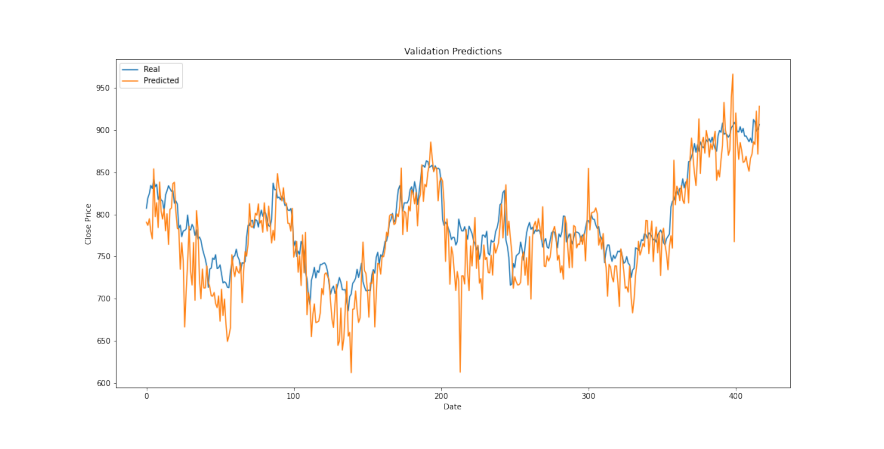

In [22]:
images = []
num_epochs = 995
for epoch in range(num_epochs):
    if (epoch+1)%evaluation_epoch_num == 0 or epoch == 0 or epoch == (num_epochs-1):
        image_path = os.path.join('./plots/', f'plt_epoch_{epoch+1}.png')
        image = plt.imread(image_path)
        images.append(image)
#%%capture
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,8))
plt.axis("off")

all_images = [[plt.imshow(image, animated=True)] for image in images]
plt.rcParams['animation.embed_limit'] = 2**32
ani = animation.ArtistAnimation(fig, all_images, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())